In [1]:
!pip install keras-tuner

import pandas as pd
import numpy as np
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import keras_tuner as kt

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from skimage.io import imread
from skimage.color import rgb2gray
from skimage import exposure
from skimage import color
from skimage.feature import daisy

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder

2023-08-02 09:13:41.432623: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-08-02 09:13:41.500913: I tensorflow/core/platform/cpu_feature_guard.cc:183] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE3 SSE4.1 SSE4.2 AVX, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# Load the image paths and labels from the DataFrame
df = pd.read_csv('Dataset/cards.csv')

# For column names that contain space, replace the space with an underscore
df.columns = [c.replace(' ', '_') for c in df.columns]

# Add suits column
df['suit'] = df['labels'].str.split().str[-1]

# Remove rows with jokers
df = df[~df['suit'].str.contains('joker', case=False)]

# Remove unwanted columns
df = df.drop(columns = ['data_set'])
df = df.drop(columns = ['class_index'])
df = df.drop(columns = ['labels'])
df = df.drop(columns = ['card_type'])

# Add folder name to the filepath
df['filepaths'] = df['filepaths'].apply(lambda x: 'Dataset/' + x)
df.head()

,filepaths,suit
0,Dataset/train/ace of clubs/001.jpg,clubs
1,Dataset/train/ace of clubs/002.jpg,clubs
2,Dataset/train/ace of clubs/003.jpg,clubs
3,Dataset/train/ace of clubs/004.jpg,clubs
4,Dataset/train/ace of clubs/005.jpg,clubs


In [3]:
# Split dataframe into train and test sets, stratified by the 'suit' column
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['suit'], random_state=42)

# Split train set into train and validation sets, stratified by the 'suit' column
train_df, val_df = train_test_split(train_df, test_size=0.2, stratify=train_df['suit'], random_state=42)

# Check class distribution in the train, validation, and test sets
train_class_distribution = train_df['suit'].value_counts(normalize=True)
val_class_distribution = val_df['suit'].value_counts(normalize=True)
test_class_distribution = test_df['suit'].value_counts(normalize=True)

print("Train Set - Class Distribution:")
print(train_class_distribution)

print("Validation Set - Class Distribution:")
print(val_class_distribution)

print("Test Set - Class Distribution:")
print(test_class_distribution)

Train Set - Class Distribution:
spades      0.269171
hearts      0.246010
diamonds    0.243675
clubs       0.241144
Name: suit, dtype: float64
Validation Set - Class Distribution:
spades      0.269261
hearts      0.245914
diamonds    0.243580
clubs       0.241245
Name: suit, dtype: float64
Test Set - Class Distribution:
spades      0.268991
hearts      0.245953
diamonds    0.244085
clubs       0.240971
Name: suit, dtype: float64


## Augment Images

In [4]:
# Initialize data generator class

train_data_generator = ImageDataGenerator(
#     rescale = 1/255.0,
    rotation_range= 45,
#     zoom_range= 0.2,
#     width_shift_range = 0.2,
#     height_shift_range = 0.2,
    shear_range= 0.2,
    horizontal_flip=True,
    vertical_flip=True
)

test_data_generator = ImageDataGenerator(rescale = 1/255.0)

# Create data generators for train, validation, and test
batch_size = 32

train_generator = train_data_generator.flow_from_dataframe(
    dataframe = train_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical'
)

valid_generator = train_data_generator.flow_from_dataframe(
    dataframe = val_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical'
)


test_generator = test_data_generator.flow_from_dataframe(
    dataframe = test_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical',
    shuffle = False,
)


Found 5138 validated image filenames belonging to 4 classes.
Found 1285 validated image filenames belonging to 4 classes.
Found 1606 validated image filenames belonging to 4 classes.


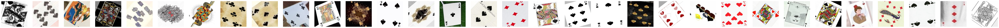

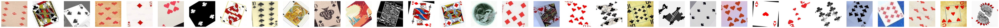

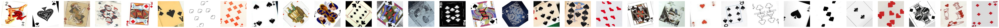

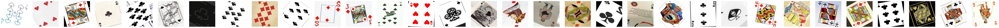

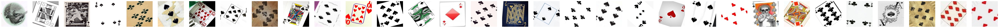

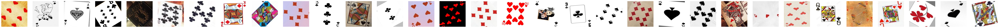

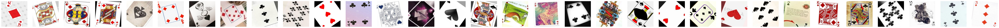

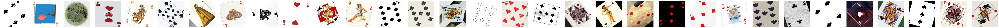

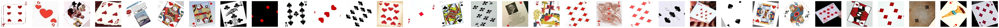

In [5]:
# Plot augmented images from a sample of 10 batches
for batch_index in range(1,10):
    image_batch, label_batch = next(train_generator)
    num_images_in_batch = image_batch.shape[0]

    plt.figure(figsize=(100, 8))
    for i in range(num_images_in_batch):
        plt.subplot(1, num_images_in_batch, i + 1)
        plt.imshow(image_batch[i].astype('uint8'))
        plt.axis('off')
    plt.show()

## Load, Preprocess, and Extract

In [6]:
def load_and_preprocess_image(filepath):
    image = cv2.imread(filepath)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))
    image_norm = image.astype('float32')
    norm = image_norm / 255.0
    return norm

# Convert images to grayscale
def convert_to_grayscale(images):
    gray_images = np.array([cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in images])
    return gray_images

# Extract Daisy features from the images
def extract_daisy_features(images):
    daisy_features = []
    for img in images:
        daisy_feature = daisy(img, step=16, radius=15, rings=2, histograms=8,
                              orientations=8, visualize=False)
        daisy_features.append(daisy_feature.reshape(-1))
    return np.array(daisy_features)

## Extract Features

In [7]:
# Load data from the generators and extract HOG features
train_images = np.array([load_and_preprocess_image(train_generator.filepaths[i]) for i in range(len(train_generator.filenames))])
valid_images = np.array([load_and_preprocess_image(valid_generator.filepaths[j]) for j in range(len(valid_generator.filenames))])
test_images = np.array([load_and_preprocess_image(test_generator.filepaths[k]) for k in range(len(test_generator.filenames))])

# Convert to grayscale
train_gray_images = convert_to_grayscale(train_images)
valid_gray_images = convert_to_grayscale(valid_images)
test_gray_images = convert_to_grayscale(test_images)

# Extract HOG feature vectors
train_hog_features = extract_daisy_features(train_gray_images)
valid_hog_features = extract_daisy_features(valid_gray_images)
test_hog_features = extract_daisy_features(test_gray_images)

# Convert labels to arrays and one-hot encode 
train_labels = to_categorical(train_generator.labels, num_classes=4)
valid_labels = to_categorical(valid_generator.labels, num_classes=4)
test_labels = to_categorical(test_generator.labels, num_classes=4)


## CNN Model with Hyperparameter Search

In [8]:
def cnn_model(hp):
    model = Sequential()
    model.add(Dense(units=hp.Int('units', min_value=64, max_value=512, step=32), activation='relu', input_shape=(train_hog_features.shape[1],)))
    model.add(Dense(num_classes, activation='softmax'))

    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', values=[1e-4, 1e-5, 1e-6])), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

In [9]:
def hyperparameter_search(train_data, train_labels, valid_data, valid_labels):
    tuner = kt.RandomSearch(
        cnn_model,
        objective='val_accuracy',
        max_trials=10,  # Number of hyperparameter combinations to try
        directory='hyperparameter_search',
        project_name='hog_classifier'
    )

    # Perform the hyperparameter search
    tuner.search(train_data, train_labels, epochs=10, validation_data=(valid_data, valid_labels))

    # Get the best hyperparameters
    best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

    return best_hps

In [10]:
num_classes = 4

# Perform hyperparameter search
best_hyperparameters = hyperparameter_search(train_hog_features, train_labels, valid_hog_features, valid_labels)
print("Best hyperparameters:")
print(best_hyperparameters)


INFO:tensorflow:Reloading Tuner from hyperparameter_search/hog_classifier/tuner0.json
INFO:tensorflow:Oracle triggered exit
Best hyperparameters:


In [11]:
# Train the model with the best hyperparameters
final_cnn_model = cnn_model(best_hyperparameters)
history = final_cnn_model.fit(train_hog_features, 
                              train_labels, epochs=50, 
                              batch_size=32, 
                              validation_data=(valid_hog_features, valid_labels))


2023-08-02 09:17:25.361927: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:999] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-02 09:17:25.433151: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:999] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-02 09:17:25.433199: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:999] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-02 09:17:25.436144: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:999] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-02 09:17:25.436185: I tensorflow/compile

Epoch 1/50


2023-08-02 09:17:26.741240: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:655] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-08-02 09:17:26.790470: I tensorflow/compiler/xla/service/service.cc:169] XLA service 0x55ea72709ad0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-08-02 09:17:26.790501: I tensorflow/compiler/xla/service/service.cc:177]   StreamExecutor device (0): NVIDIA GeForce RTX 4090, Compute Capability 8.9
2023-08-02 09:17:26.813931: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-08-02 09:17:26.856589: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:424] Loaded cuDNN version 8902
2023-08-02 09:17:27.026860: I ./tensorflow/compiler/jit/device_compiler.h:180] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the p

161/161 [==============================] - 1s 4ms/step - loss: 1.3464 - accuracy: 0.3427 - val_loss: 1.2952 - val_accuracy: 0.4257
Epoch 2/50
161/161 [==============================] - 1s 3ms/step - loss: 1.2523 - accuracy: 0.4432 - val_loss: 1.2187 - val_accuracy: 0.4903
Epoch 3/50
161/161 [==============================] - 1s 3ms/step - loss: 1.1717 - accuracy: 0.5257 - val_loss: 1.1576 - val_accuracy: 0.5479
Epoch 4/50
161/161 [==============================] - 1s 3ms/step - loss: 1.1013 - accuracy: 0.5763 - val_loss: 1.1123 - val_accuracy: 0.5572
Epoch 5/50
161/161 [==============================] - 0s 3ms/step - loss: 1.0446 - accuracy: 0.5991 - val_loss: 1.0731 - val_accuracy: 0.5735
Epoch 6/50
161/161 [==============================] - 0s 3ms/step - loss: 0.9884 - accuracy: 0.6339 - val_loss: 1.0341 - val_accuracy: 0.6023
Epoch 7/50
161/161 [==============================] - 0s 3ms/step - loss: 0.9414 - accuracy: 0.6592 - val_loss: 1.0064 - val_accuracy: 0.6148
Epoch 8/50
161/16

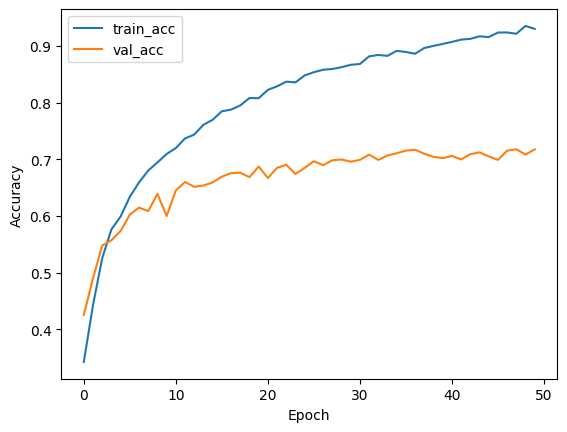

In [12]:
# Plot accuracy
plt.plot(history.history['accuracy'], label='train_acc')
plt.plot(history.history['val_accuracy'], label='val_acc')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

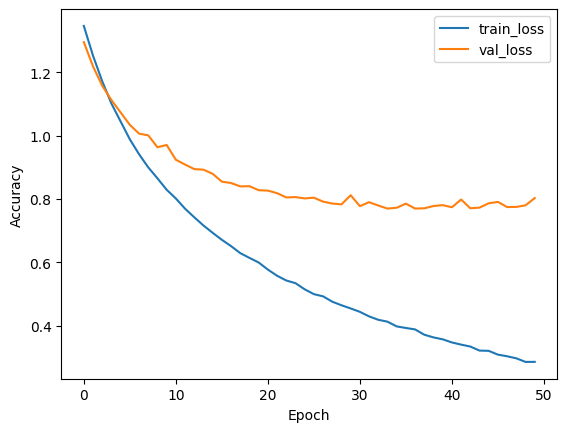

In [13]:
#Plot Loss
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [14]:
# Make predictions on the validation set
valid_predictions_probs = final_cnn_model.predict(valid_hog_features)
valid_predictions = np.argmax(valid_predictions_probs, axis=1)
valid_accuracy = accuracy_score(valid_generator.labels, valid_predictions) # Calculate validation accuracy
print("Validation Accuracy:", valid_accuracy)

# Make predictions on the test set
test_predictions_probs = final_cnn_model.predict(test_hog_features)
test_predictions = np.argmax(test_predictions_probs, axis=1)
test_accuracy = accuracy_score(test_generator.labels, test_predictions) # Calculate test accuracy
print("Test Accuracy:", test_accuracy)

41/41 [==============================] - 0s 977us/step
Validation Accuracy: 0.7175097276264591
51/51 [==============================] - 0s 968us/step
Test Accuracy: 0.7185554171855542


## Classification Report

In [15]:
# Get the class names from the generator (assuming it has the 'class_indices' attribute)
class_names = list(test_generator.class_indices.keys())

# Calculate classification report for validation set
valid_report = classification_report(valid_generator.labels, valid_predictions, target_names=class_names)
print("Validation Classification Report:\n", valid_report)

# Calculate classification report for test set
test_report = classification_report(test_generator.labels, test_predictions, target_names=class_names)
print("Test Classification Report:\n", test_report)

Validation Classification Report:
               precision    recall  f1-score   support

       clubs       0.76      0.62      0.68       310
    diamonds       0.63      0.83      0.71       313
      hearts       0.76      0.74      0.75       316
      spades       0.76      0.68      0.72       346

    accuracy                           0.72      1285
   macro avg       0.73      0.72      0.72      1285
weighted avg       0.73      0.72      0.72      1285

Test Classification Report:
               precision    recall  f1-score   support

       clubs       0.74      0.65      0.69       387
    diamonds       0.64      0.79      0.70       392
      hearts       0.75      0.74      0.75       395
      spades       0.77      0.69      0.73       432

    accuracy                           0.72      1606
   macro avg       0.72      0.72      0.72      1606
weighted avg       0.73      0.72      0.72      1606



## Confusion Matrix

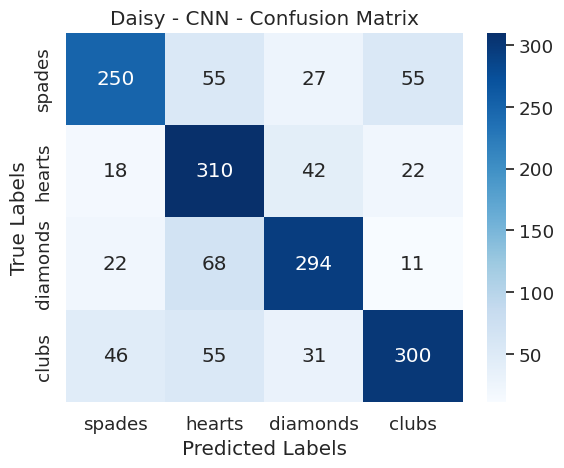

In [16]:
conf_matrix = confusion_matrix(test_generator.labels, test_predictions)

# Define the class labels
class_labels = ['spades', 'hearts', 'diamonds', 'clubs']

# Create the seaborn heatmap
sns.set(font_scale=1.2)
sns.heatmap(conf_matrix, 
            annot=True, 
            fmt="d", 
            cmap="Blues", 
            xticklabels=class_labels, 
            yticklabels=class_labels)

# Add labels and title
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Daisy - CNN - Confusion Matrix")

# Show the plot
plt.show()